# Set-Up & Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [43]:
import os
from typing import List, Optional, Tuple

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import torch
import torch.nn.functional as F
from keras.datasets import fashion_mnist
from PIL import Image
from sklearn.decomposition import PCA
from torch import Tensor, nn, optim
from torch.cuda.amp import GradScaler
from torch.optim.optimizer import Optimizer
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from torchsummary import summary
from tqdm.auto import tqdm


# Checking if CUDA is available
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {DEVICE} device")

# define path to store latent space embeddings
LSPATH = "data/latent_space"
if not os.path.exists(LSPATH):
    os.makedirs(LSPATH)

Using cuda device


In [3]:
def plot_components(
    components: np.ndarray, labels: np.ndarray, variance: Optional[np.ndarray] = None
) -> Tuple[plt.Figure, plt.Axes]:
    """
    Plot the components of the PCA or other dimensionality reduction algorithm.

    Parameters
    ----------
    components : np.ndarray
        The components of the dimensionality reduction algorithm.
    labels : np.ndarray
        The labels of the data.
    variance : np.ndarray, optional
        The explained variance of each component, by default None
    """

    fig, axis = plt.subplots(figsize=(4, 4))

    for label in set(labels):
        axis.scatter(
            components[labels == label, 0],
            components[labels == label, 1],
            label=label,
            alpha=0.2,
            s=2,
        )

    axis.legend(bbox_to_anchor=(1.1, 1.05))

    if variance is not None:
        axis.set_xlabel(f"PCA 1 ({variance[0]:.2f}%)")
        axis.set_ylabel(f"PCA 2 ({variance[1]:.2f}%)")

    return fig, axis

In [4]:
def collate_fn(batch: List[Tuple[Tensor, int]]) -> Tuple[Tensor, Tensor]:
    """
    Collate function for FashionMNIST dataloader.

    Combines images and labels into separate tensors
    """

    process = transforms.Compose(
        [transforms.ToTensor(), transforms.Pad(2)]  # add 2px padding to each side
    )

    # process images in batch
    images = torch.stack([process(img) for img, _ in batch])

    # get labels
    labels = torch.LongTensor([label for _, label in batch])

    return images, labels

In [5]:
def plot_latent(*args):
    pass

In [42]:
def train(
    model: nn.Module,
    train_loader: DataLoader,
    optimizer: Optimizer,
    criterion: nn.Module,
    scaler: GradScaler,
    save_embedding: bool = False,
) -> float:
    """
    Run a single training epoch.

    Parameters
    ----------
    model : nn.Module
        PyTorch model to train
    train_loader : DataLoader
        data loader for training data
    optimizer : Optimizer
        training optimizer
    criterion : nn.Module
        loss function
    scaler : GradScaler
        scaler for mixed precision training
    save_embedding : bool, optional
        save latent space embedding, by default False

    Returns
    -------
    float
        average loss
    """

    # train model
    model.train()

    # keep track of losses
    train_loss = 0.0

    # tqdm bar for training batches
    train_bar = tqdm(
        total=len(train_loader),
        dynamic_ncols=True,
        leave=False,
        position=0,
        desc="Training",
    )

    # train model
    for batch, (images, labels) in enumerate(train_loader):
        # move to device
        images = images.to(DEVICE)

        # use mixed precision training
        with torch.cuda.amp.autocast():
            embedding = model.encoder(images)
            reconstruction = model.decoder(embedding)
            loss = criterion(reconstruction, images)

        # backprop
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        # update loss
        train_loss += loss.item() * images.size(0)

        # update tqdm bar
        train_bar.set_postfix(
            loss=f"{train_loss / (batch + 1):.4f}",
            lr=f"{optimizer.param_groups[0]['lr']:.2e}",
        )
        train_bar.update()

        # save latent space embedding
        if save_embedding and batch % 10 == 0:
            # current epoch (add 1 because we start at 0)
            epoch = model.TRAINED_EPOCHS + 1

            # convert embedding and labels to numpy arrays
            embedding = embedding.detach().cpu().numpy()
            labels = labels.detach().cpu().numpy()

            # path to save embedding
            path = "data/latent_space"
            if not os.path.exists(path):
                os.makedirs(path)

            # save embedding and labels
            np.savez(
                f"{path}/latent_space_E{epoch}_B{batch}.npz",
                points=embedding,
                labels=labels,
            )

    # update trained epochs
    model.TRAINED_EPOCHS += 1

    # close tqdm bar
    train_bar.close()

    # return average loss
    return train_loss / len(train_loader.dataset)

In [36]:
def validate(model: nn.Module, valid_loader: DataLoader, criterion: nn.Module) -> float:
    """
    Run a single validation epoch.

    Parameters
    ----------
    model : nn.Module
        PyTorch model to train
    valid_loader : DataLoader
        data loader for validation data
    criterion : nn.Module
        loss function

    Returns
    -------
    float
        average loss
    """

    # eval model
    model.eval()

    # keep track of losses
    valid_loss = 0.0

    # tqdm bar for training batches
    train_bar = tqdm(
        total=len(valid_loader),
        dynamic_ncols=True,
        leave=False,
        position=0,
        desc="Validation",
    )

    # train model
    for batch, (images, _) in enumerate(valid_loader):
        # move to device
        images = images.to(DEVICE)

        # forward pass
        with torch.no_grad():
            y_hat = model(images)
            loss = criterion(y_hat, images)

        # update loss
        valid_loss += loss.item() * images.size(0)

        # update tqdm bar
        train_bar.set_postfix(
            loss=f"{valid_loss / (batch + 1):.4f}",
        )
        train_bar.update()

    # close tqdm bar
    train_bar.close()

    # return average loss
    return valid_loss / len(valid_loader.dataset)

## Load & Prepare Data

In [22]:
# load training and test data
(X_train, y_train), (X_test, y_test) = fashion_mnist.load_data()

# combine training and test data
X = np.concatenate((X_train, X_test))
y = np.concatenate((y_train, y_test))

# reshape data to 1D
X = X.reshape(X.shape[0], X.shape[1] * X.shape[2])

print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")

X shape: (70000, 784)
y shape: (70000,)


## PCA

In [23]:
%%time
# PCA with 2 components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

CPU times: user 25.8 s, sys: 20.6 s, total: 46.4 s
Wall time: 27 s


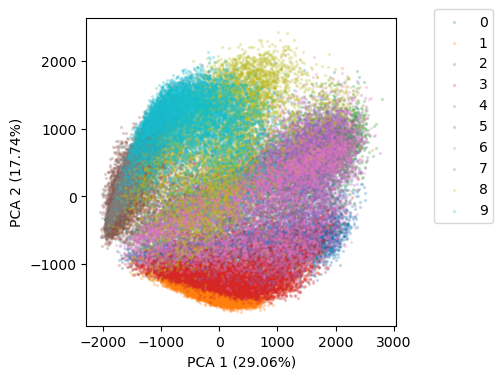

In [24]:
# Visualize projection on 2 components
fig, ax = plot_components(X_pca, y, pca.explained_variance_ratio_ * 100)

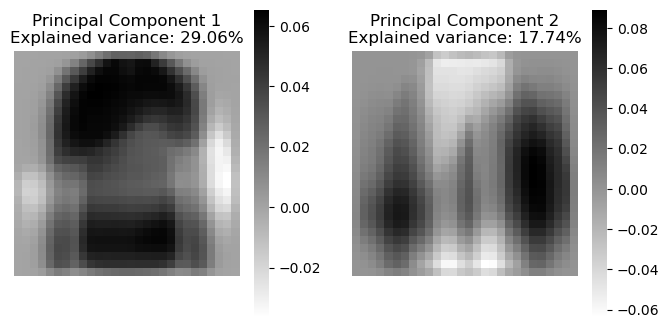

In [25]:
# Construct image from principal components
PC1 = pca.components_[0, :].reshape(28, 28)
PC2 = pca.components_[1, :].reshape(28, 28)

# Visualize prinicipal components
fig, axes = plt.subplots(1, 2, figsize=(8, 4))

for i, (ax, component, variance) in enumerate(zip(axes, [PC1, PC2], pca.explained_variance_ratio_)):
    sns.heatmap(component, cmap='gray_r', ax=ax)
    ax.set_title(f"Principal Component {i+1}\nExplained variance: {variance * 100:.2f}%")
    ax.axis('off')
    ax.set_aspect('equal')

## Simple Convolutional Autoencoder

In [62]:
# define configuration
config = {
    "batch-size": 4096,
    "epochs": 10,
    "lr": 5e-4,
    "ae": {
        "layers": 3,
        "linear-dim": 2048,
        "kernels": [3, 3, 3],
        "channels": [32, 64, 128],
        "strides": [2, 2, 2]
    }
}

# define labels
classes = [
    "T-shirt/top", 
    "Trouser", 
    "Pullover", 
    "Dress", 
    "Coat", 
    "Sandla", 
    "Shirt", 
    "Sneaker", 
    "Bag", 
    "Ankle boot"
]

In [63]:
# download/load dataset
train_data = datasets.FashionMNIST("data/FashionMNIST", train=True, download=True)
valid_data = datasets.FashionMNIST("data/FashionMNIST", train=False, download=True)

# put datasets into dataloaders
train_loader = DataLoader(
    train_data, 
    batch_size=config["batch-size"], 
    shuffle=True, 
    collate_fn=collate_fn
)
valid_loader = DataLoader(
    valid_data, 
    batch_size=config["batch-size"], 
    shuffle=False,
    collate_fn=collate_fn
)

Inspecting training data
Batch shape: torch.Size([1024, 1, 32, 32])


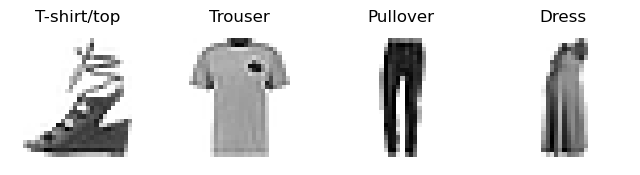

In [28]:
print("Inspecting training data")
for images, labels in train_loader:
    print("Batch shape:", images.shape)

    fig, ax = plt.subplots(1, 4, figsize=(8, 4))

    for i in range(4):
        ax[i].imshow(images[i, 0], cmap='gray_r')
        ax[i].axis('off')
        ax[i].set_title(classes[i])

    break

### Encoder

In [31]:
class Encoder(nn.Module):
    """Encoder for AE"""

    def __init__(
        self,
        output_dim=2,
        use_batchnorm=False,
        use_dropout=False,
    ):
        # inherit from parent class
        super(Encoder, self).__init__()

        # define output dimension (size of latent space)
        self.output_dim = output_dim

        # variables deciding whether to use batchnorm and dropout
        self.use_batchnorm = use_batchnorm
        self.use_dropout = use_dropout

        # convolutional layer hyperparameters (from config)
        self.layers = config['ae']['layers']
        self.kernels = config['ae']['kernels']
        self.channels = config['ae']['channels']
        self.strides = config['ae']['strides']
        self.conv = self.get_convs()

        # layers for latent space projection
        self.fc_dim = config['ae']['linear-dim']
        self.flatten = nn.Flatten()
        self.linear = nn.Linear(self.fc_dim, self.output_dim)

    def get_convs(self):
        """Generate convolutional layers based on hyperparameters"""
        
        conv_layers = nn.Sequential()

        for i in range(self.layers):
            # the input channel of the first layer is 1
            if i == 0:
                conv_layers.append(
                    nn.Conv2d(
                        in_channels=1,
                        out_channels=self.channels[i],
                        kernel_size=self.kernels[i],
                        stride=self.strides[i],
                        padding=1,
                    )
                )
            else:
                conv_layers.append(
                    nn.Conv2d(
                        in_channels=self.channels[i-1],
                        out_channels=self.channels[i],
                        kernel_size=self.kernels[i],
                        stride=self.strides[i],
                        padding=1,
                    )
                )

            if self.use_batchnorm:
                conv_layers.append(nn.BatchNorm2d(self.channels[i]))

            # Use GeLU as activation function
            conv_layers.append(nn.GELU())

            if self.use_dropout:
                conv_layers.append(nn.Dropout2d(0.15))
                                   
        return conv_layers

    def forward(self, x):
        x = self.conv(x)
        x = self.flatten(x)
        x = self.linear(x)
        return x
    
# summarize model architecture
encoder = Encoder(use_batchnorm=True, use_dropout=True)
summary(encoder, (1, 32, 32));
del encoder

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 128, 4, 4]           --
|    └─Conv2d: 2-1                       [-1, 32, 16, 16]          320
|    └─BatchNorm2d: 2-2                  [-1, 32, 16, 16]          64
|    └─GELU: 2-3                         [-1, 32, 16, 16]          --
|    └─Dropout2d: 2-4                    [-1, 32, 16, 16]          --
|    └─Conv2d: 2-5                       [-1, 64, 8, 8]            18,496
|    └─BatchNorm2d: 2-6                  [-1, 64, 8, 8]            128
|    └─GELU: 2-7                         [-1, 64, 8, 8]            --
|    └─Dropout2d: 2-8                    [-1, 64, 8, 8]            --
|    └─Conv2d: 2-9                       [-1, 128, 4, 4]           73,856
|    └─BatchNorm2d: 2-10                 [-1, 128, 4, 4]           256
|    └─GELU: 2-11                        [-1, 128, 4, 4]           --
|    └─Dropout2d: 2-12                   [-1, 128, 4, 4]           --
├─Fl

### Decoder

In [32]:
class Decoder(nn.Module):

    def __init__(
        self,
        input_dim=2,
        use_batchnorm=False,
        use_dropout=False,
    ):
        # inherit from parent class
        super(Decoder, self).__init__()

        # define input dimension (size of latent space)
        self.input_dim = input_dim

        # variables deciding whether to use batchnorm and dropout
        self.use_batchnorm = use_batchnorm
        self.use_dropout = use_dropout

        # convolutional layer hyperparameters (from config; reversed)
        self.layers = config['ae']['layers']
        self.kernels = config['ae']['kernels'][::-1]
        self.channels = config['ae']['channels'][::-1]
        self.strides = config['ae']['strides'][::-1]

        # in decoder, first do fc projection then conv layers
        self.fc_dim = config['ae']['linear-dim']
        self.linear = nn.Linear(self.input_dim, self.fc_dim)
        self.conv = self.get_convs()

        # define output layer (convert to 1 channel)
        self.output = nn.Conv2d(
            in_channels=self.channels[-1],
            out_channels=1,
            kernel_size=1,
            stride=1,
        )

    def get_convs(self):
        """Generate convolutional layers based on hyperparameters"""
        
        conv_layers = nn.Sequential()

        for i in range(self.layers):
            # the input channel of the first layer is 1
            if i == 0:
                conv_layers.append(
                    nn.ConvTranspose2d(
                        in_channels=self.channels[i],
                        out_channels=self.channels[i],
                        kernel_size=self.kernels[i],
                        stride=self.strides[i],
                        padding=1,
                        output_padding=1
                    )
                )
            else:
                conv_layers.append(
                    nn.ConvTranspose2d(
                        in_channels=self.channels[i-1], 
                        out_channels=self.channels[i],
                        kernel_size=self.kernels[i],
                        stride=self.strides[i],
                        padding=1,
                        output_padding=1
                    )
                )

            if self.use_batchnorm and i != self.layers - 1:
                conv_layers.append(nn.BatchNorm2d(self.channels[i]))

            # Use GeLU as activation function
            conv_layers.append(nn.GELU())

            if self.use_dropout:
                conv_layers.append(nn.Dropout2d(0.15))
                                   
        return conv_layers
    
    def forward(self, x):
        x = self.linear(x)
        # reshape 3D tensor to 4D tensor
        x = x.reshape(x.shape[0], 128, 4, 4)
        x = self.conv(x)
        x = self.output(x)
        return x
    
# summarize model architecture
decoder = Decoder(use_batchnorm=True, use_dropout=True)
summary(decoder, (2, ));
del decoder

Layer (type:depth-idx)                   Output Shape              Param #
├─Linear: 1-1                            [-1, 2048]                6,144
├─Sequential: 1-2                        [-1, 32, 32, 32]          --
|    └─ConvTranspose2d: 2-1              [-1, 128, 8, 8]           147,584
|    └─BatchNorm2d: 2-2                  [-1, 128, 8, 8]           256
|    └─GELU: 2-3                         [-1, 128, 8, 8]           --
|    └─Dropout2d: 2-4                    [-1, 128, 8, 8]           --
|    └─ConvTranspose2d: 2-5              [-1, 64, 16, 16]          73,792
|    └─BatchNorm2d: 2-6                  [-1, 64, 16, 16]          128
|    └─GELU: 2-7                         [-1, 64, 16, 16]          --
|    └─Dropout2d: 2-8                    [-1, 64, 16, 16]          --
|    └─ConvTranspose2d: 2-9              [-1, 32, 32, 32]          18,464
|    └─GELU: 2-10                        [-1, 32, 32, 32]          --
|    └─Dropout2d: 2-11                   [-1, 32, 32, 32]          

### Putting it together: Autoencoder

In [65]:
class AutoEncoder(nn.Module):
    """Autoencoder model"""""

    def __init__(self):
        # inherit from parent class
        super(AutoEncoder, self).__init__()

        # define encoder and decoder
        self.encoder = Encoder(
            output_dim=2,
            use_batchnorm=True,
            use_dropout=True,
        )
        self.decoder = Decoder(
            input_dim=2,
            use_batchnorm=True,
            use_dropout=True,
        )

        # keep track of trained epochs
        self.TRAINED_EPOCHS = 0

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# instantiate model and move to GPU
model = AutoEncoder()
model.to(DEVICE);

# define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.AdamW(model.parameters(), lr=config['lr'], weight_decay=1e-5)

# enable mixed precision training
scaler = torch.cuda.amp.GradScaler()

In [34]:
def plotting(model: nn.Module, step: int=0, epoch: int=None, show=False):

    model.eval()  # set model to evaluation mode

    # keep track of points and labels
    points = []
    label_idcs = []

    # define path to save images
    path = "figures/scatter-plots"
    if not os.path.exists(path): os.mkdir(path)

    # iterate over validation batches
    for images, labels in valid_loader:
        # move to device
        images = images.to(DEVICE)
        labels = labels.to(DEVICE)

        # encode images to obtain latent space
        latent = model.encoder(images)
        points.extend( latent.detach().cpu().numpy() )
        label_idcs.extend( labels.detach().cpu().numpy() )

        del images, labels, latent

    # convert to numpy array
    points = np.array(points)

    # save `points` and `label_idcs` to npy file
    dpath = "data/latent"
    if not os.path.exists(dpath): os.mkdir(dpath)
    if epoch is not None:
        np.savez(f"{dpath}/Epoch_{epoch:03d}_Step_{step:03d}.npz", points=points, label_idcs=label_idcs)
    else:
        np.savez(f"{dpath}/Final.npz", points=points, label_idcs=label_idcs)

    # create scatter plot
    fig, ax = plt.subplots(figsize=(10, 10) if not show else (5, 5))
    ax.scatter(
        x=points[:, 0],
        y=points[:, 1],
        c=label_idcs,
        s=2,
        cmap='tab10',
        alpha=0.9,
        zorder=2
    )

    # appearance
    ax.spines[['top', 'right']].set_visible(False)
    ax.spines[['bottom', 'left']].set_linewidth(0.5)
    ax.minorticks_on()
    ax.grid(True, which='major', linestyle='-', color='lightgray', alpha=0.4, zorder=0)
    ax.grid(True, which='minor', linestyle='--', color='lightgray', alpha=0.3, zorder=0)

    # labels
    ax.set_xlabel("Latent Dimension 1", fontsize=12)
    ax.set_ylabel("Latent Dimension 2", fontsize=12)
    if epoch is not None:
        ax.set_title(f"Latent Space at Step {step}, Epoch {epoch}", fontsize=14)
    else:
        ax.set_title(f"Latent Space at Step {step}", fontsize=14)

    # save and show
    if show:
        plt.show()
    else:
        # don't show but save during training
        if epoch is not None:
            plt.savefig(f"{path}/Epoch_{epoch:03d}_Step_{step:03d}.png", bbox_inches='tight')
        else:
            plt.savefig(f"{path}/Step_{step:03d}.png", bbox_inches='tight')
        plt.close()
        model.train()


def save_gif():
    """convert image sequence to gif file"""

    frames = []
    imgs = sorted(os.listdir("figures/scatter-plots"))

    for img in imgs:
        frame = Image.open(f"figures/scatter-plots/{img}")
        frames.append(frame)
    
    frames[0].save(
        "figures/latent-space.gif", 
        format="GIF", 
        append_images=frames[1:], 
        save_all=True, 
        duration=200, 
        loop=0
    )

In [59]:
def train(model, dataloader, criterion, optimizer, epoch=None, save_distrib=False):
    """Training function"""

    # use steos to track training progress (for latent space plots)
    global steps

    # train mode
    model.train()

    # keep track of losses
    train_loss = 0.0

    # process tqdm bar
    batch_bar = tqdm(
        total=len(dataloader),
        dynamic_ncols=True,
        leave=False,
        position=0,
        desc=f"Train"
    )

    for i, (images, _) in enumerate(dataloader):
        # move to device
        images = images.to(DEVICE)

        # use mixed precision training
        with torch.cuda.amp.autocast():
            y_hat = model(images)
            loss = criterion(y_hat, images)

        # backpropagation
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        # update loss
        train_loss += loss.item() * images.size(0)

        # update tqdm bar
        batch_bar.set_postfix(
            loss=f"{train_loss  / (i+1):.4f}",
            lr=f"{optimizer.param_groups[0]['lr']:.4f}"
        )
        batch_bar.update()

        # save latent space distribution
        if steps % 10 == 0 and save_distrib and steps <= 400:
            plotting(model, step=steps, epoch=epoch)
        steps += 1

        # remove cache in cuda memory
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        del images, y_hat

    # close tqdm bar
    batch_bar.close()

    # calculate average loss
    train_loss /= len(dataloader.dataset)

    return train_loss

In [60]:
def validate(model, dataloader, criterion):
    """Validation function"""

    # eval mode
    model.eval()

    # keep track of losses
    valid_loss = 0.0

    # progress tqdm bar
    batch_bar = tqdm(
        total=len(dataloader),
        dynamic_ncols=True,
        leave=False,
        position=0,
        desc=f"Valid"
    )

    for i, (images, _) in enumerate(dataloader):
        images = images.to(DEVICE)

        with torch.no_grad():
            y_hat = model(images)
            loss = criterion(y_hat, images)

        # update loss
        valid_loss += loss.item() * images.size(0)

        # update tqdm bar
        batch_bar.set_postfix(
            loss=f"{valid_loss / (i+1):.4f}",
            lr=f"{optimizer.param_groups[0]['lr']:.4f}"
        )
        batch_bar.update()

        # remove cache in cuda memory
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        del images, y_hat

    # close tqdm bar
    batch_bar.close()

    # calculate average loss
    valid_loss /= len(dataloader.dataset)

    return valid_loss

In [41]:
save_gif()

In [41]:
model.TRAINED_EPOCHS

590

In [66]:
for epoch in range(config['epochs']):
    cur_lr = float(optimizer.param_groups[0]['lr'])

    train_loss = train(
        model,
        train_loader,
        optimizer,
        criterion,
        scaler,
        save_embedding=True
    )

    valid_loss = validate(model, valid_loader, criterion)

    print((
        f"Epoch {epoch+1}/{config['epochs']}\n"
        f"Learning Rate: {cur_lr:.4f}\n"
        f"Train Loss: {train_loss:.4f}\n"
        f"Valid Loss: {valid_loss:.4f}\n\n"
    ))

Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1/10
Learning Rate: 0.0005
Train Loss: 0.1239
Valid Loss: 0.1212




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2/10
Learning Rate: 0.0005
Train Loss: 0.0580
Valid Loss: 0.0583




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3/10
Learning Rate: 0.0005
Train Loss: 0.0433
Valid Loss: 0.0353




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4/10
Learning Rate: 0.0005
Train Loss: 0.0386
Valid Loss: 0.0330




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5/10
Learning Rate: 0.0005
Train Loss: 0.0365
Valid Loss: 0.0320




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6/10
Learning Rate: 0.0005
Train Loss: 0.0352
Valid Loss: 0.0313




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7/10
Learning Rate: 0.0005
Train Loss: 0.0342
Valid Loss: 0.0308




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8/10
Learning Rate: 0.0005
Train Loss: 0.0334
Valid Loss: 0.0304




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9/10
Learning Rate: 0.0005
Train Loss: 0.0327
Valid Loss: 0.0298




Training:   0%|          | 0/15 [00:00<?, ?it/s]

Validation:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10/10
Learning Rate: 0.0005
Train Loss: 0.0320
Valid Loss: 0.0293




In [44]:
from glob import glob
import re

In [ ]:
files = sorted(glob(f"{LSPATH}/*.npz"))

# to mapt epochs and batches to indices
epoch_dict, batch_dict = {}, {}

# load first file to get the shape
data = np.load(files[0])
points, labels = data['points'], data['labels']
num_images, points_dim = points.shape

# create arrays to store all points and labels
points_data = np.empty((0, 0, num_images, points_dim))
labels_data = np.empty((0, 0, num_images))

# loop through all files
for i, file in enumerate(files):
    # extract epoch and batch number
    match = re.search(r"Epoch_(\d+)_Step_(\d+).npz", file)
    if not match:
        print(f"File {file} does not match regex")
        continue
    epoch, batch = int(match.group(1)), int(match.group(2))

    # if this is the first time seeing this epoch/batch, add to dict
    if epoch not in epoch_dict:
        epoch_dict[epoch] = len(epoch_dict)
    if batch not in batch_dict:
        batch_dict[batch] = len(batch_dict)

    # load data
    data = np.load(file)
    points, labels = data['points'], data['labels']

    # expand the points_data and labels_data if necessary

In [68]:
points, labels = [], []

for file in sorted(glob(f"{LSPATH}/*.npz")):
    with np.load(file) as data:
        _points = data['points']
        _labels = data['labels']

    match = re.search(r'_E(\d+)_B(\d+)', file)

    if not match:
        print(f"Error: {file}")
        continue

    epoch, batch = int(match.group(1)), int(match.group(2))

    print(f"Epoch {epoch}, Batch {batch}: {_points.shape[0]} points, {_labels.shape[0]} labels")and

Epoch 10, Batch 0: 4096 points, 4096 labels
Epoch 10, Batch 10: 4096 points, 4096 labels
Epoch 1, Batch 0: 4096 points, 4096 labels
Epoch 1, Batch 10: 4096 points, 4096 labels
Epoch 2, Batch 0: 4096 points, 4096 labels
Epoch 2, Batch 10: 4096 points, 4096 labels
Epoch 3, Batch 0: 4096 points, 4096 labels
Epoch 3, Batch 10: 4096 points, 4096 labels
Epoch 4, Batch 0: 4096 points, 4096 labels
Epoch 4, Batch 10: 4096 points, 4096 labels
Epoch 5, Batch 0: 4096 points, 4096 labels
Epoch 5, Batch 10: 4096 points, 4096 labels
Epoch 6, Batch 0: 4096 points, 4096 labels
Epoch 6, Batch 10: 4096 points, 4096 labels
Epoch 7, Batch 0: 4096 points, 4096 labels
Epoch 7, Batch 10: 4096 points, 4096 labels
Epoch 8, Batch 0: 4096 points, 4096 labels
Epoch 8, Batch 10: 4096 points, 4096 labels
Epoch 9, Batch 0: 4096 points, 4096 labels
Epoch 9, Batch 10: 4096 points, 4096 labels


In [53]:
np.array(points).shape

(60, 1024, 2)

In [49]:
labelss.shape

(1024,)

In [27]:
from glob import glob
import re

import numpy as np

import plotly.graph_objects as go

In [25]:
latent_embed = []
sample_labels = []

for s, file in enumerate(sorted(glob("data/latent/*.npz"))):
    # extract epoch and step from file name
    epoch, step = re.findall(r"\d+", file)
    epoch, step = int(epoch), int(step)

    # load vars from npz file
    var = np.load(file)
    latent, labels = var['points'], var['label_idcs']

    # append to list
    latent_embed.append(latent)
    sample_labels.append(labels)

latent_embed = np.stack(latent_embed)
sample_labels = np.stack(sample_labels)

In [31]:
sample_labels[0,:].shape

(10000,)

In [38]:
frames = [
    go.Frame(
        data=[ go.Scatter(
            x=latent_embed[i, :, 0],
            y=latent_embed[i, :, 1],
            mode='markers',
            marker=dict(
                size=2,
                color=sample_labels[i, :],
                colorscale='Viridis',
                opacity=0.8
            )
        ) ],
        name=str(i)
    )
    for i in range(latent_embed.shape[0])
]

sliders = [{
    "steps": [{
        "method": "animate"
    }],
    "transition": {"duration": 300}
}]

data = [go.Scatter(
    x=latent_embed[0, :, 0],
    y=latent_embed[0, :, 1],
    mode='markers',
    marker=dict(
        size=2,
        color=sample_labels[0, :],
        colorscale='Viridis',
        opacity=0.8
    )
)]

layout = go.Layout(
    width=700,
    height=700,
    autosize=False,
    title="Latent Space Embedding across Training",
    hovermode="closest",
    updatemenus=[{
        "type": "buttons",
        "showactive": False,
        "buttons": [{
            "label": "Play",
            "method": "animate",
            "args": [
                None,
                {
                    "frame": {
                        "duration": 300,
                        "redraw": True
                    },
                    "fromcurrent": True,
                }
            ]
        }]
    }],
    sliders=sliders
)

fig = go.Figure(
    data=data,
    layout=layout,
    frames=frames
)
fig.show()